# /r/place 2022 History

/r/place was created in April of 2022 as a blank canvas for anyone to edit. Edits were only allowed to be made once every 5 minutes per user. The result was a natural social experiment that took the internet by storm!

[https://en.wikipedia.org/wiki/Place_(Reddit)](https://en.wikipedia.org/wiki/Place_(Reddit\))

https://www.reddit.com/r/place

From Wikipedia:

The experiment was based in a subreddit called /r/place, in which registered users could place a single colored pixel (or "tile") on an empty canvas of one million (1000x1000) pixel squares, and wait a certain amount of time before placing another. In 2017 the waiting time varied from 5 to 20 minutes throughout the experiment, and the user could choose their pixel’s color from a palette of sixteen colors.

## 2022
On March 28, 2022, a reboot of Place was announced. It began on April 1, 2022, and lasted for four days. Unlike in 2017, individual subreddits immediately began to coordinate pixel art, and large communities were formed on Discord and Twitch in attempts to create, defend, and destroy territory. There was a sixfold increase in the number of users on Reddit between the two experiments (from about 1 million in the 2017 iteration compared to 6 million in 2022). Different communities collaborated and formed alliances through Discord as well as subreddits. Large streamers on Twitch also participated by instructing thousands (in some cases hundreds of thousands) of their viewers to mark their logos and symbols. In response to the project's popularity, Reddit doubled the canvas's size and expanded the color palette on days 2 and 3. On the fourth day, the palette was reduced to only white, with which the entire canvas was blanked.

In [78]:
import pandas as pd
import numpy as np

from glob import glob
from tqdm.notebook import tqdm
import cv2

from matplotlib import pyplot as plt, cm
from matplotlib import colors

import plotly.express as px

In [2]:
# Pull in list of images
imgs_single = glob('../input/reddit-rplace-2022-history/*/*.png')
imgs_multi = glob('../input/reddit-rplace-2022-history/*/*/*.png')
imgs = imgs_single + imgs_multi

## Canvas Setup
Canvas Were released in order 0, 1, and then 2&3 at the same time.
```
-----------------
|       |        |
|   0   |   1    |
|       |        |
-----------------
|       |        |
|   2   |   3    |
|       |        |
-----------------
```

## Create Metadata Dataframe

This metadata includes the:
- Full file location
- Filename
- Canvas number
- `ts` int representation of the timestamp
- `dt` datetime representation of the pull

In [9]:
%load_ext lab_black

In [18]:
def get_metadata(imgs, save=False):
    meta_data = pd.DataFrame(imgs, columns=["filename_full"])
    meta_data["filename"] = (
        meta_data["filename_full"].str.split("/").str[3:].str.join("/")
    )
    meta_data["file"] = meta_data["filename"].str.split("/").str[-1]
    meta_data["canvas"] = meta_data["file"].str.split("-").str[0].astype("int")
    meta_data["ts"] = (
        meta_data["file"].str.split("-").str[1].str.strip(".png").astype("int")
    )
    meta_data["dt"] = pd.to_datetime(meta_data["ts"], unit="s")
    meta_data = meta_data.sort_values("dt").reset_index(drop=True)
    if save:
        meta_data.to_csv("place_metadata.csv", index=False)
        meta_data.to_parquet("place_metadata.parquet")
    return meta_data


meta_data = get_metadata(imgs)

In [14]:
# Start and End Time of the Data Coverage
meta_data["dt"].min(), meta_data["dt"].max()

(Timestamp('2022-04-01 14:15:00'), Timestamp('2022-04-05 07:30:23'))

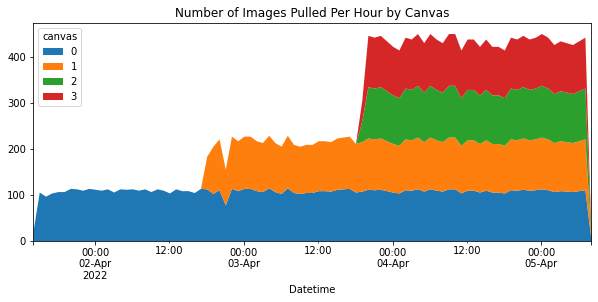

In [15]:
# Round to the minute
meta_data["dt_h"] = meta_data["dt"].round("h")
pull_count = (
    meta_data.groupby(["dt_h", "canvas"]).size().unstack().fillna(0).astype("int")
)
fig, ax = plt.subplots(figsize=(10, 4))
pull_count.plot(
    ax=ax,
    title="Number of Images Pulled Per Hour by Canvas",
    kind="area",
    stacked="True",
    lw=0,
)
ax.set_xlabel("Datetime")
plt.show()

# Near Final View of Combined Canvas
- Pull all 4 canvas images
- combine into single image and show.

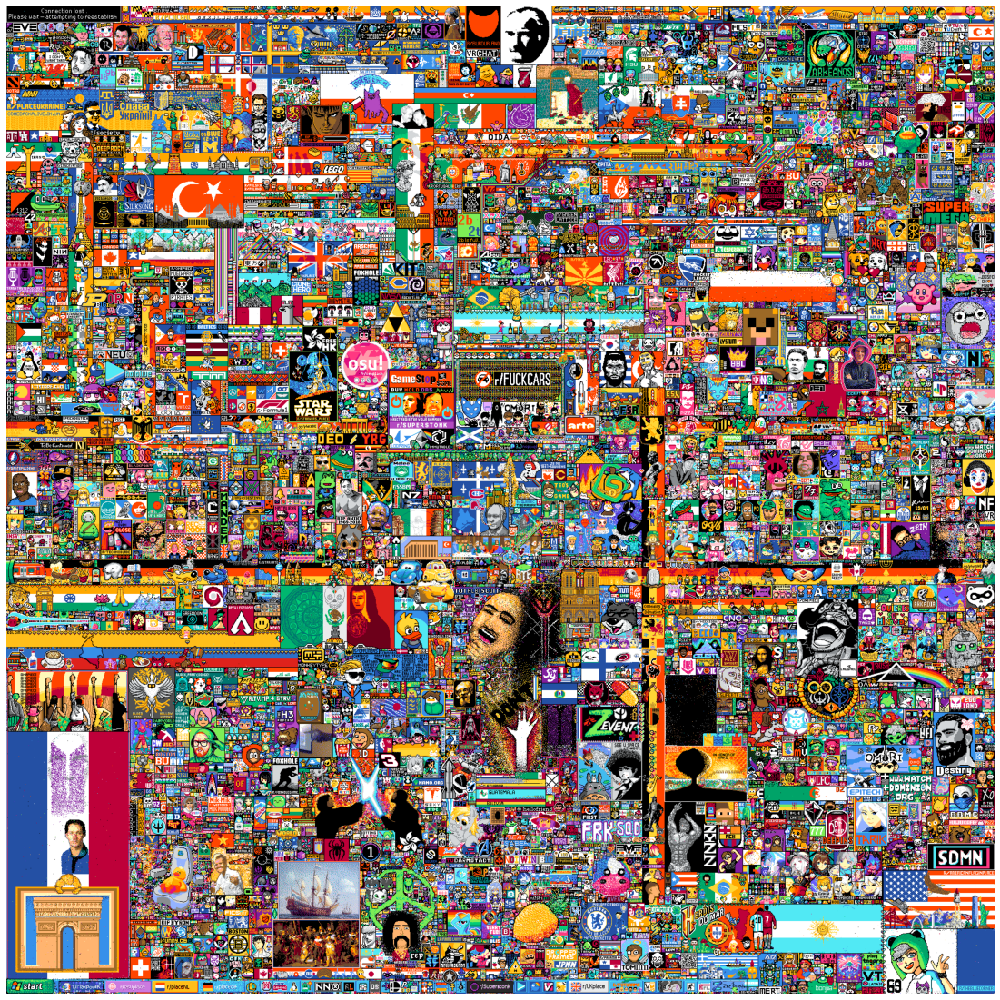

In [20]:
c0 = meta_data.query("canvas == 0")["filename_full"].values[-1000]
c1 = meta_data.query("canvas == 1")["filename_full"].values[-1000]
c2 = meta_data.query("canvas == 2")["filename_full"].values[-1000]
c3 = meta_data.query("canvas == 3")["filename_full"].values[-1000]

imgc0 = plt.imread(c0)
imgc1 = plt.imread(c1)
imgc2 = plt.imread(c2)
imgc3 = plt.imread(c3)

fig, ax = plt.subplots(figsize=(20, 20))

img_combined = np.concatenate(
    [np.concatenate([imgc0, imgc1], axis=1), np.concatenate([imgc2, imgc3], axis=1)],
    axis=0,
)

ax.imshow(img_combined)
ax.axis("off")
plt.show()

# Helper Functions

In [67]:
def load_combine_canvas(row):
    imgc0 = plt.imread(row[0])
    if type(row[1]) == str:
        imgc1 = plt.imread(row[1])
    else:
        imgc1 = np.zeros_like(imgc0)

    if type(row[2]) == str:
        imgc2 = plt.imread(row[2])
    else:
        imgc2 = np.zeros_like(imgc0)

    if type(row[3]) == str:
        imgc3 = plt.imread(row[3])
    else:
        imgc3 = np.zeros_like(imgc0)

    img_combined = np.concatenate(
        [
            np.concatenate([imgc0, imgc1], axis=1),
            np.concatenate([imgc2, imgc3], axis=1),
        ],
        axis=0,
    )
    return img_combined


def unstack_metadata(meta_data):
    # Metadata when there are 4 canvas
    four_views = meta_data.groupby(["dt", "canvas"])["filename_full"].first().unstack()
    return four_views

In [23]:
four_views = unstack_metadata(meta_data)

In [25]:
# four_views

# Early View of Each Canvas

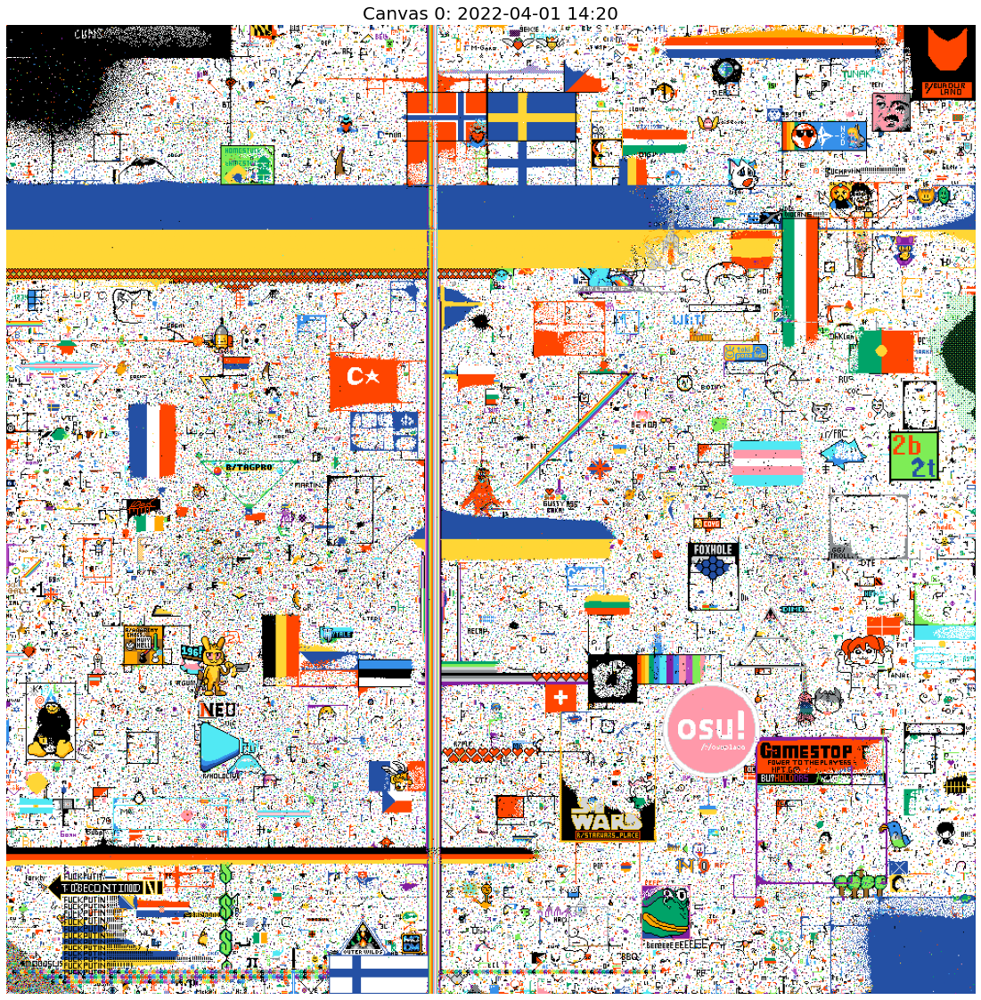

In [26]:
canvas = 0
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[5]
mydt = meta_data.query("canvas == @canvas")["dt"].values[5]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

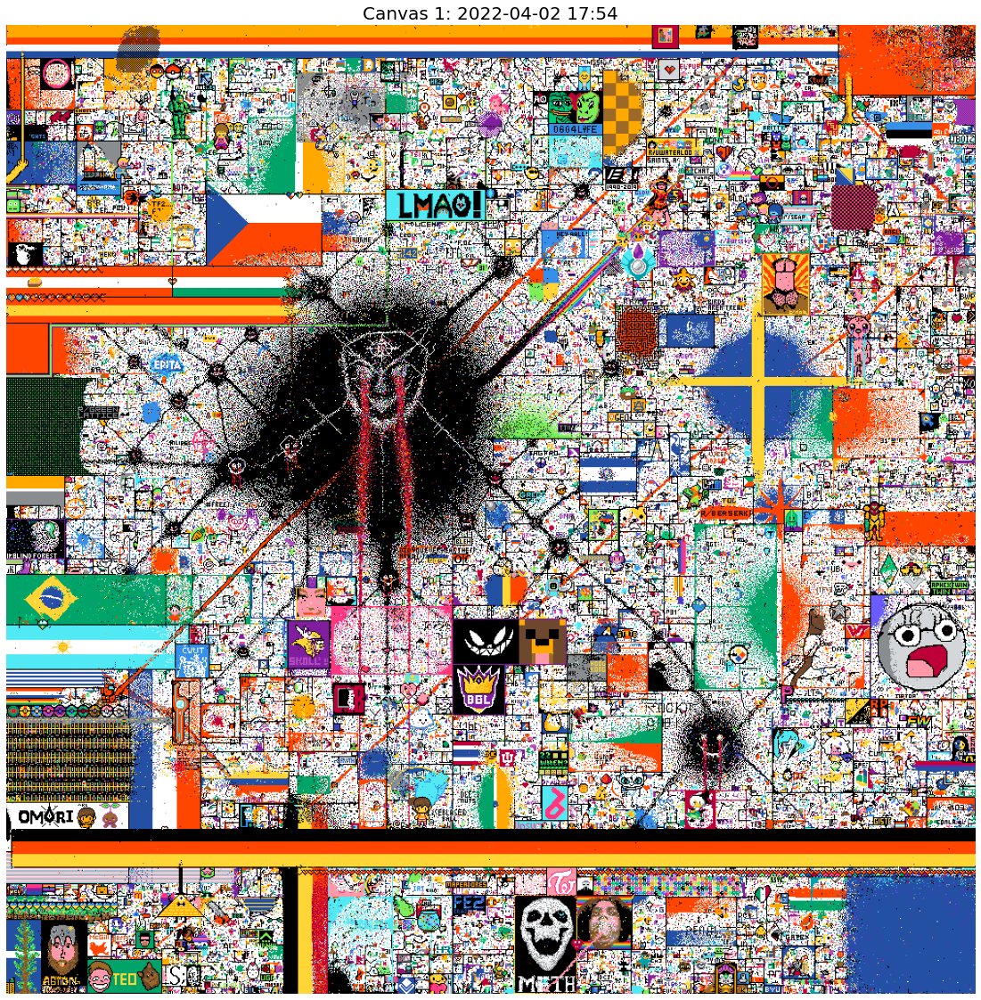

In [27]:
canvas = 1
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[5]
mydt = meta_data.query("canvas == @canvas")["dt"].values[5]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

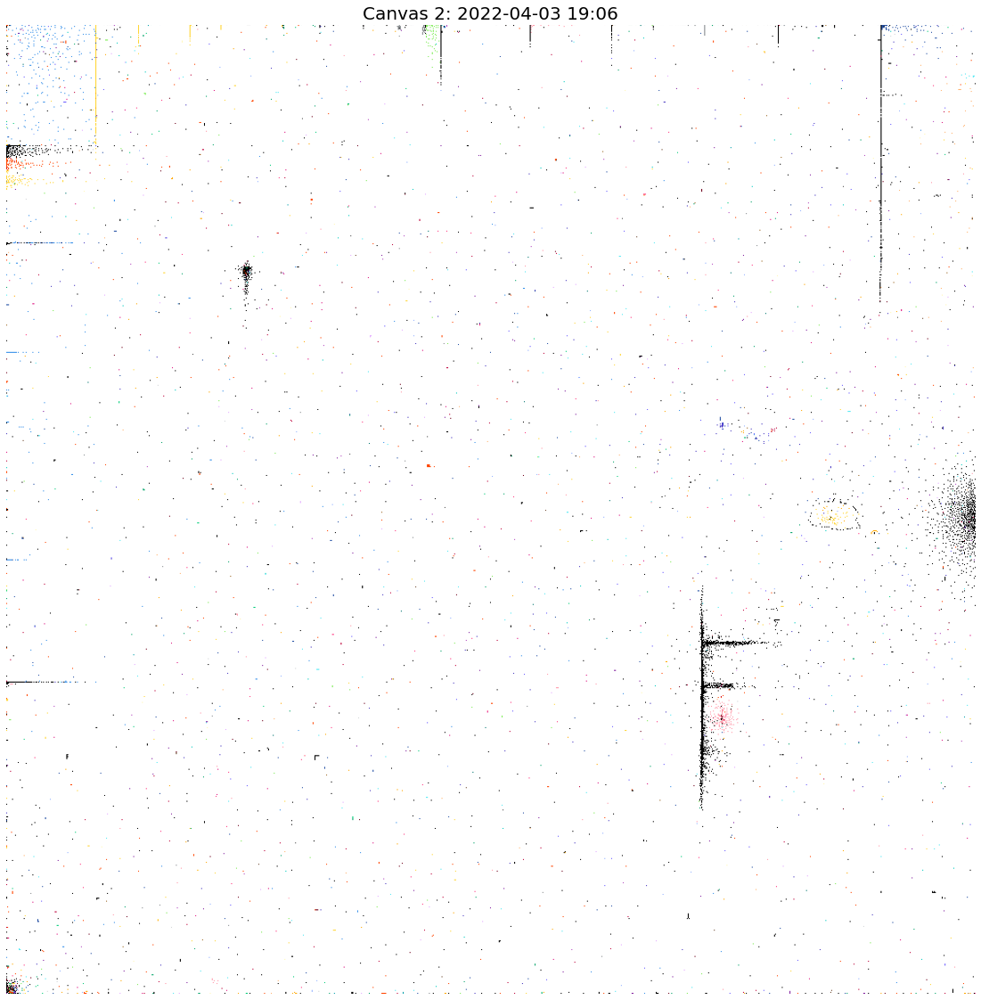

In [28]:
canvas = 2
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[5]
mydt = meta_data.query("canvas == @canvas")["dt"].values[5]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

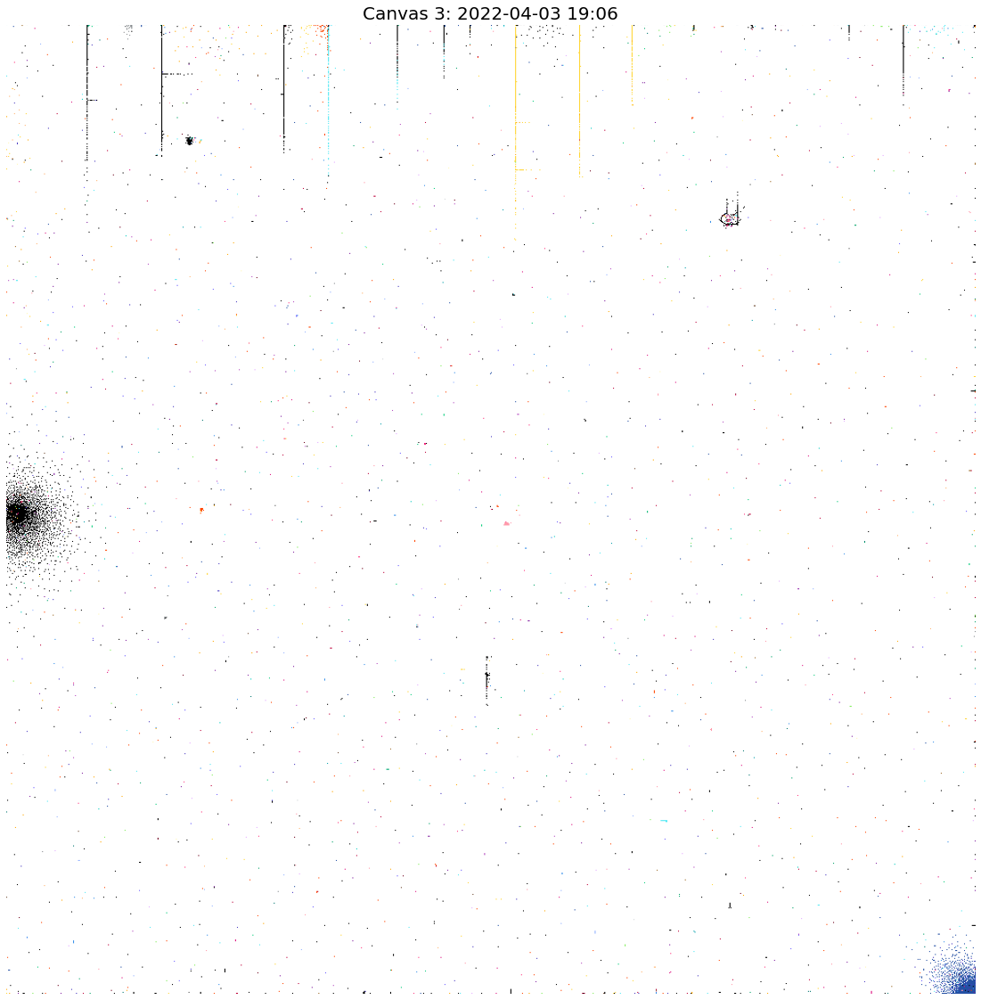

In [29]:
canvas = 3
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[5]
mydt = meta_data.query("canvas == @canvas")["dt"].values[5]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

# Late view of each canvas

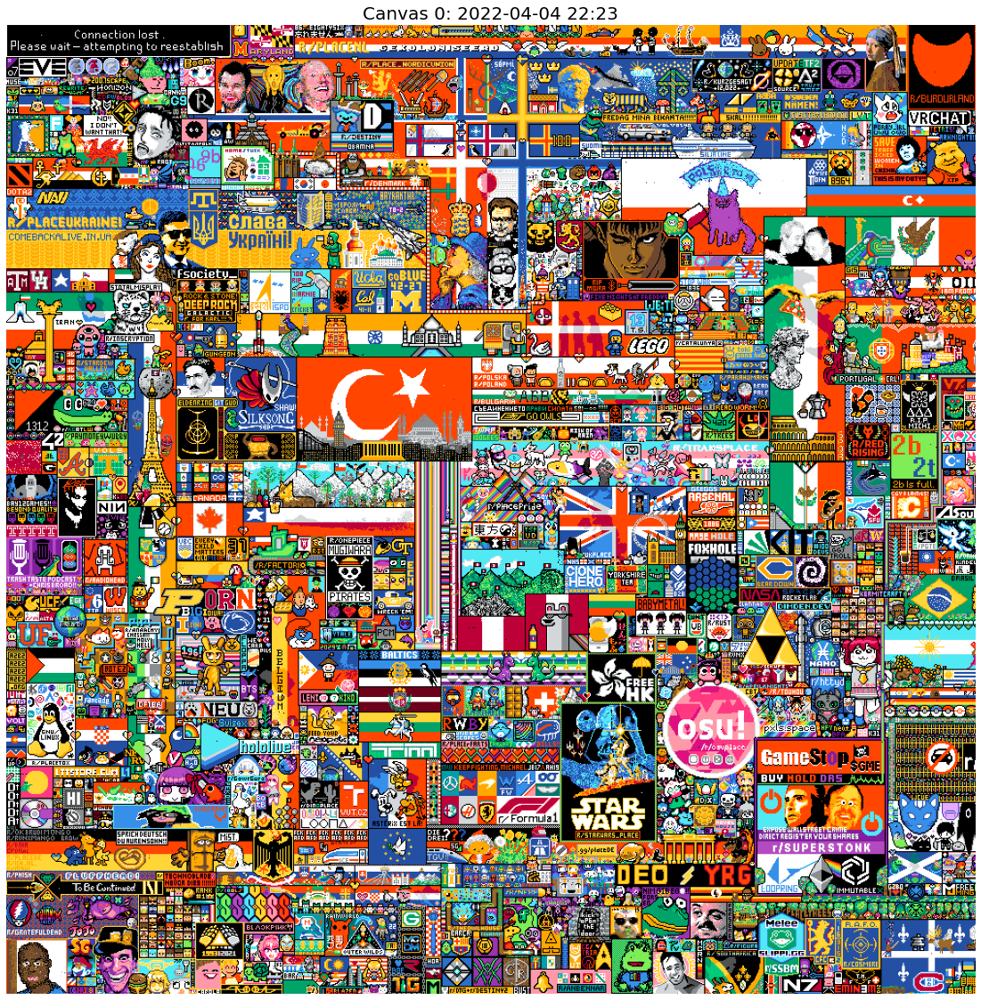

In [30]:
canvas = 0
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[-1000]
mydt = meta_data.query("canvas == @canvas")["dt"].values[-1000]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

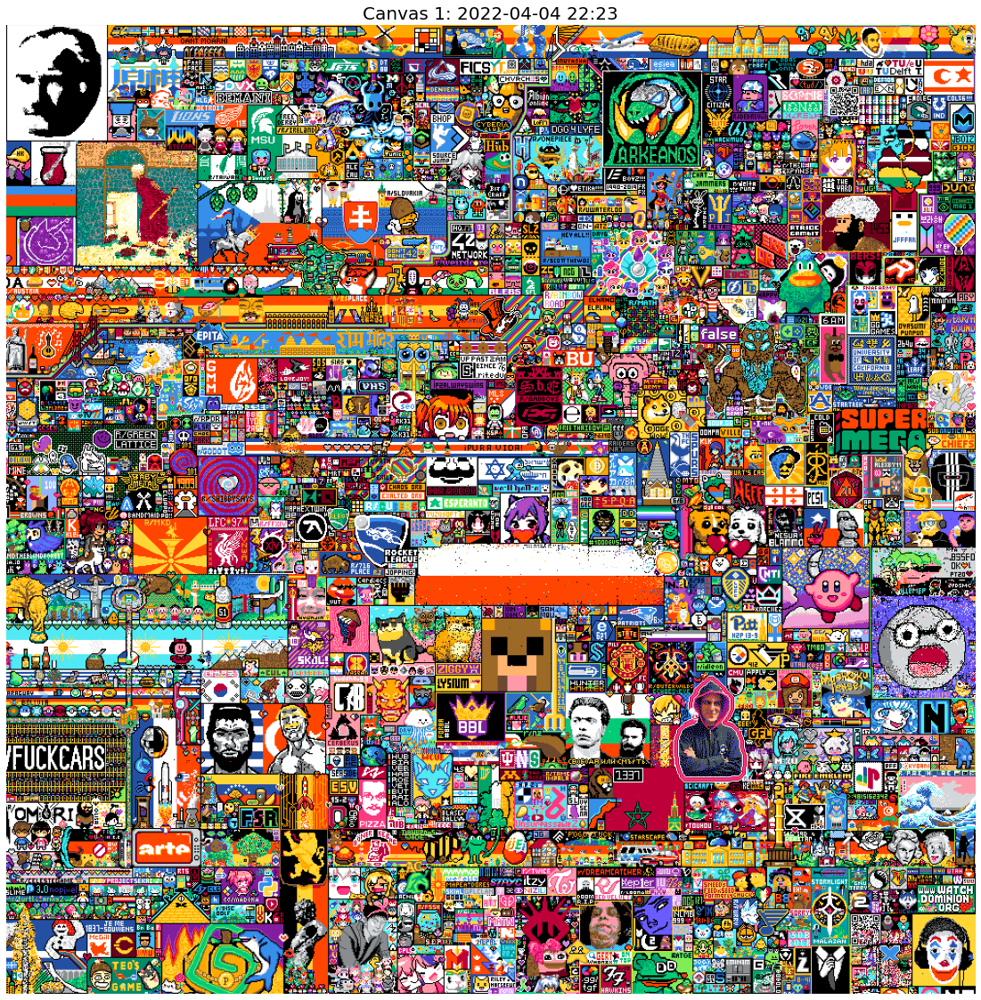

In [31]:
canvas = 1
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[-1000]
mydt = meta_data.query("canvas == @canvas")["dt"].values[-1000]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

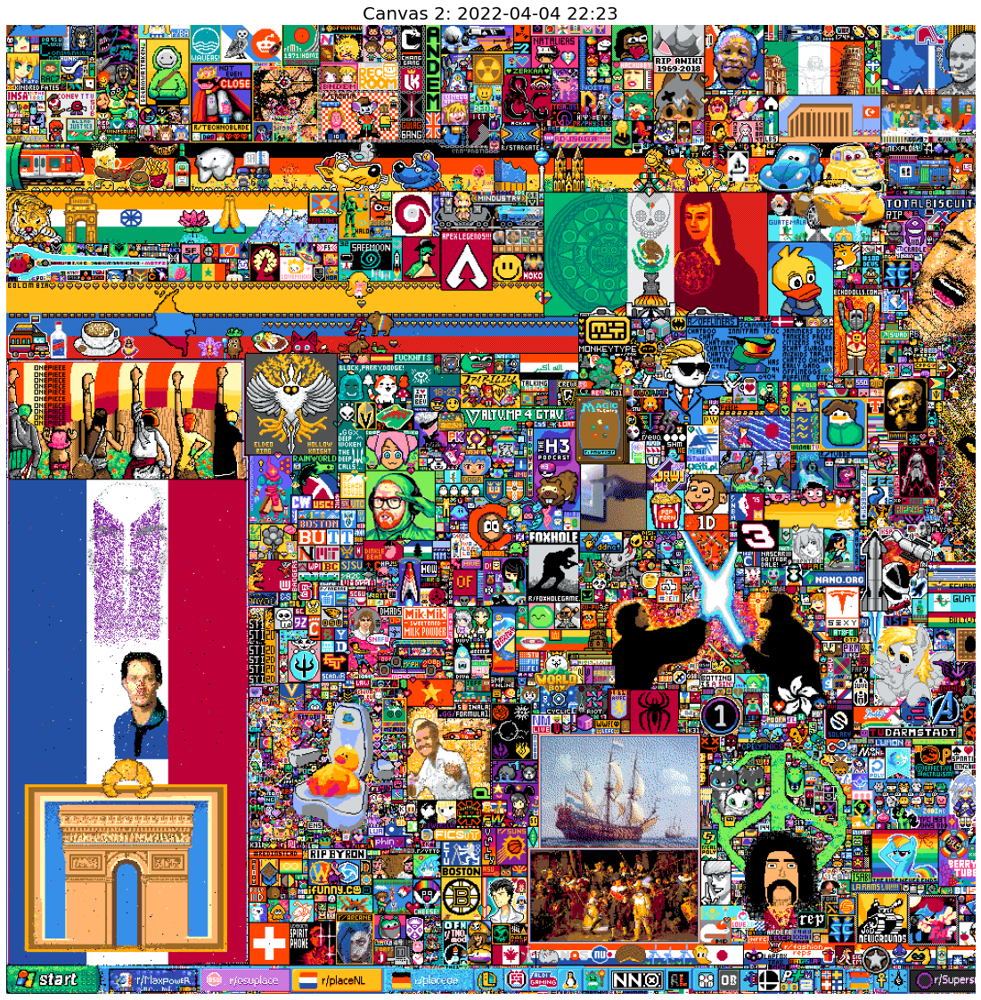

In [32]:
canvas = 2
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[-1000]
mydt = meta_data.query("canvas == @canvas")["dt"].values[-1000]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

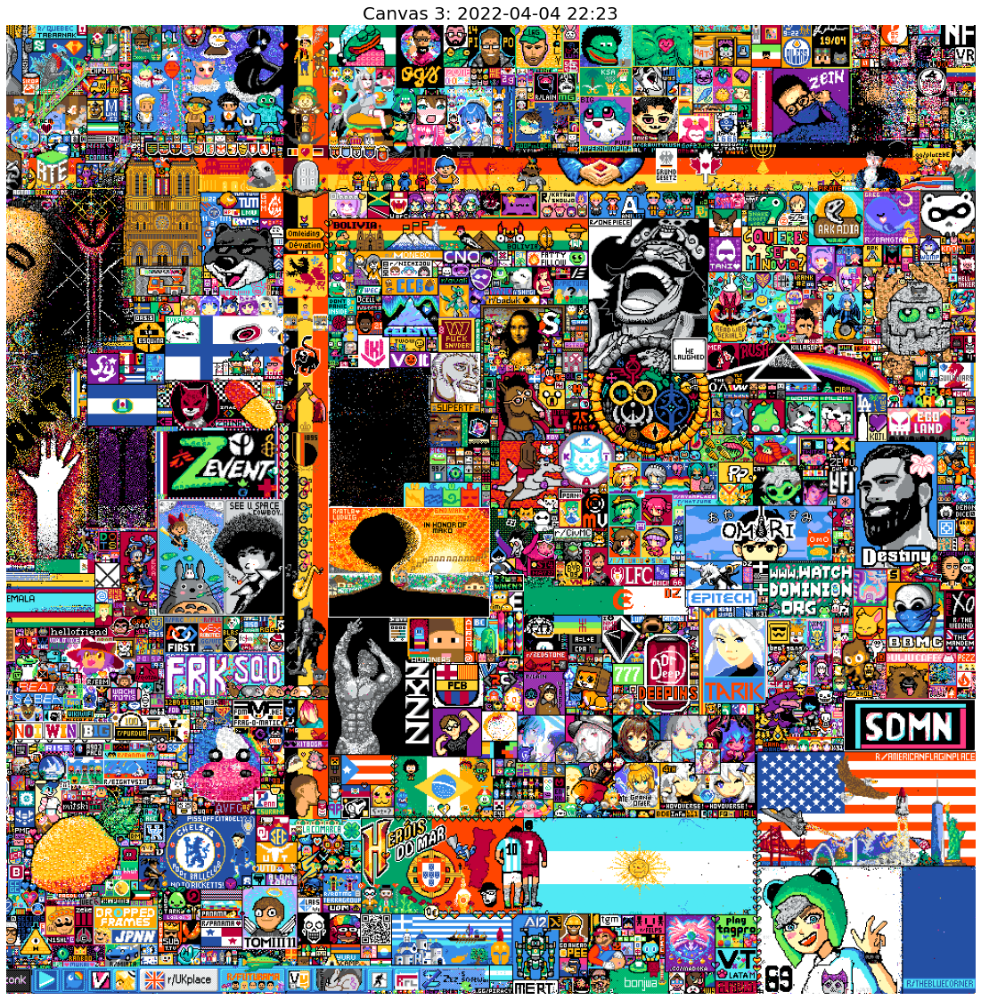

In [33]:
canvas = 3
myimg = meta_data.query("canvas == @canvas")["filename_full"].values[-1000]
mydt = meta_data.query("canvas == @canvas")["dt"].values[-1000]
mydt = pd.to_datetime(mydt)
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(plt.imread(myimg))
ax.axis("off")
ax.set_title(f"Canvas {canvas}: {mydt:%Y-%m-%d %H:%M}", fontsize=20)
plt.show()

# Pixel Activity Over The first 500 Observations
- Heatmap showing hotspots

In [55]:
# row

In [56]:
four_views

canvas,0,1,2,3
dt,,,,
2022-04-01 14:15:00,../input/reddit-rplace-2022-history/images_sin...,NaN,NaN,NaN
2022-04-01 14:15:12,../input/reddit-rplace-2022-history/images_sin...,NaN,NaN,NaN
2022-04-01 14:19:19,../input/reddit-rplace-2022-history/images_sin...,NaN,NaN,NaN
2022-04-01 14:19:51,../input/reddit-rplace-2022-history/images_sin...,NaN,NaN,NaN
2022-04-01 14:20:35,../input/reddit-rplace-2022-history/images_sin...,NaN,NaN,NaN
...,...,...,...,...
2022-04-05 07:28:18,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...
2022-04-05 07:28:49,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...
2022-04-05 07:29:20,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...,../input/reddit-rplace-2022-history/images_qua...


In [40]:
for i, row in four_views.tail(100).reset_index().loc[start_idx:end_idx].iterrows():
    break

In [54]:
# load_combine_canvas(row[1])

In [53]:
len(four_views)

9728

In [66]:
type(row[3]) == str

True

In [159]:
def do_plot(myimg, ax=None, figsize=(20, 20)):
    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(myimg)
    ax.axis("off")
    return ax

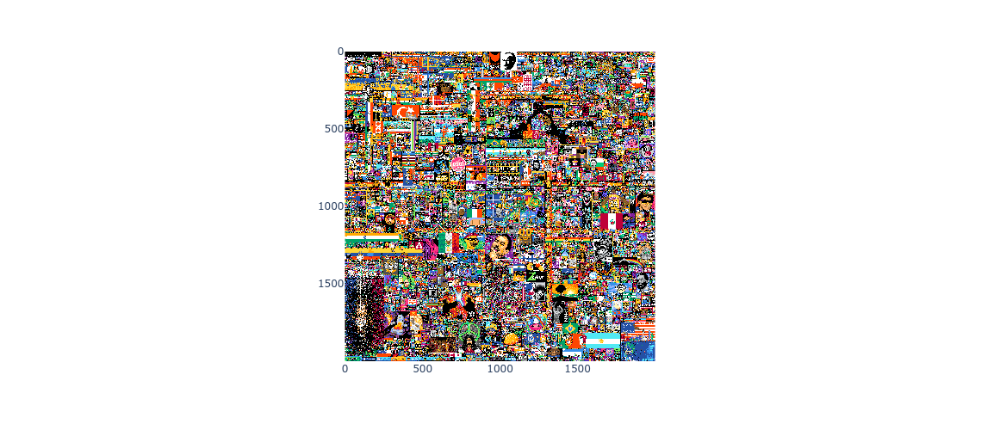

In [280]:
row = four_views.reset_index().loc[6800]
myimg = load_combine_canvas(row)
img3ch = cv2.cvtColor(myimg, cv2.COLOR_BGRA2BGR)
px.imshow(img3ch, height=500)

In [160]:
# do_plot(myimg[492:529, 175:245, :], figsize=(5, 5))

# Track the Canada Flag

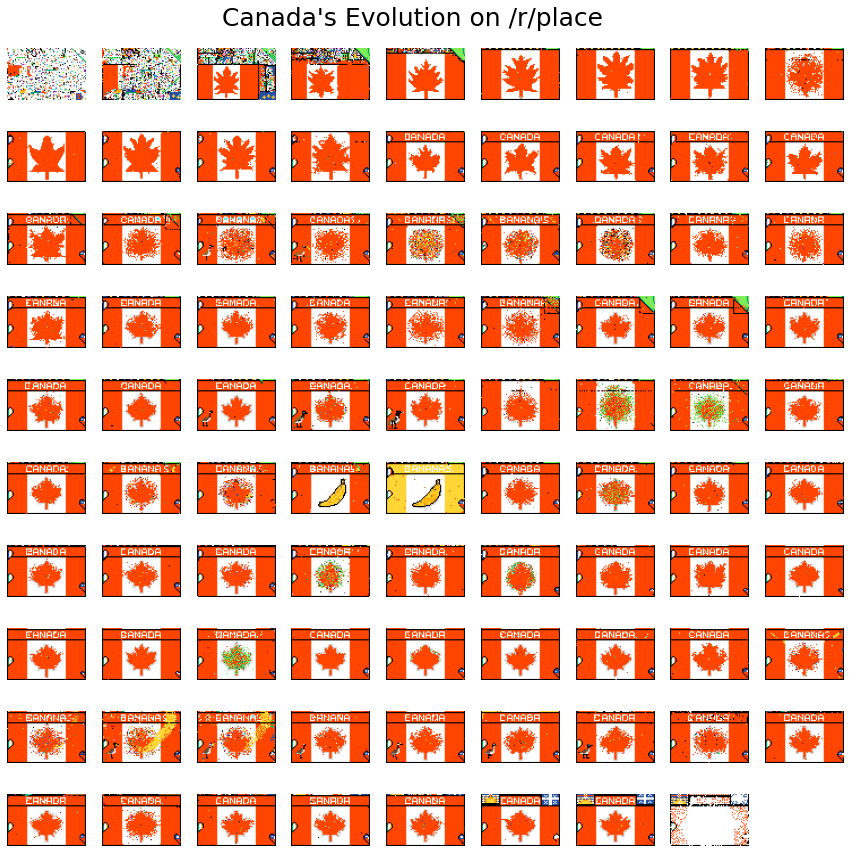

In [218]:
fig, axs = plt.subplots(10, 9, figsize=(15, 15))
axs = axs.flatten()

for i in range(90):
    row = four_views.reset_index().loc[i * 100]
    mydatetime = row["dt"]
    myimg = row[0]
    flag = plt.imread(myimg)[483:529, 175:245, :]
    do_plot(flag, axs[i], figsize=(5, 5))
    # axs[i].set_title(f"Canada Flag as of: {mydatetime:%D %H:%M:%S}")
fig.set_facecolor("white")
fig.suptitle("Canada's Evolution on /r/place", fontsize=25, y=0.91)
plt.show()

# Heatmap of the Void

In [283]:
starttime = four_views.reset_index().loc[6750]["dt"]
endtime = four_views.reset_index().loc[6850]["dt"]

void_time = four_views.loc[
    (four_views.index >= starttime) & (four_views.index <= endtime)
]

img_prev = None
changes = []
for i, row in tqdm(void_time.iterrows(), total=len(void_time)):
    if img_prev is None:
        img_prev = load_combine_canvas(row)
    img_curr = load_combine_canvas(row)
    change = (img_curr - img_prev).max(axis=2)
    changes.append(change)

  0%|          | 0/101 [00:00<?, ?it/s]

In [285]:
# @ meta_data[["dt", "canvas", "filename_full"]].head()

In [286]:
changes_ = np.stack(changes, axis=2)
changes_ = changes_.sum(axis=2)
changes_ = changes_ / changes_.max()

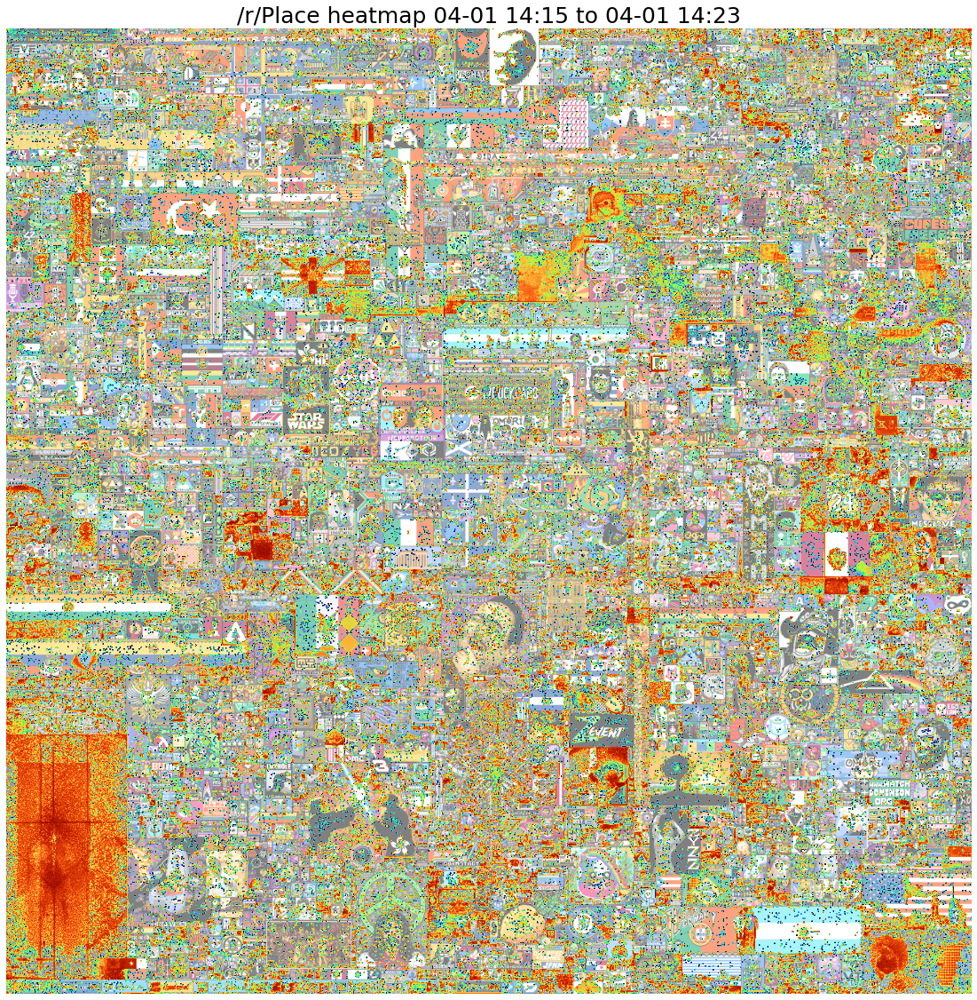

In [287]:
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(img_curr, alpha=0.5)
ax.imshow(changes_, cmap=cm.turbo, norm=colors.LogNorm())
ax.axis("off")
ax.set_title(
    f"/r/Place heatmap {start_ts:%m-%d %H:%M} to {end_ts:%m-%d %H:%M}", fontsize=25
)
fig.set_facecolor("white")
plt.show()

# Create Animation

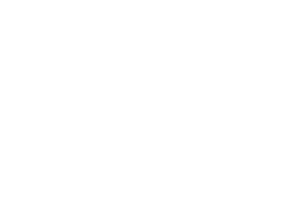

In [308]:
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np

fig, ax = plt.subplots(figsize=(5, 5))


def animation_function(i):
    # print(i)
    row = four_views.reset_index().loc[i * 50]
    mydatetime = row["dt"]
    myimg = row[0]
    flag = plt.imread(myimg)[483:529, 175:245, :]
    plt.imshow(flag)
    plt.axis("off")
    return ax


animation = FuncAnimation(
    fig,
    func=animation_function,
    frames=np.arange(0, 195, 1),
)
animation.save("test.mp4", fps=10)
plt.show()

In [212]:
# img_prior = None
# change_masks = []
# start_idx, end_idx = 0, 10
# for i, row in tqdm(
#     four_views.tail(1000).reset_index().loc[start_idx:end_idx].iterrows(),
#     total=(end_idx - start_idx),
# ):
#     if img_prior is None:
#         img_prior = load_combine_canvas(row)
#     img_current = load_combine_canvas(row)
#     change_mask = (img_prior != img_current).max(axis=2)
#     change_masks.append(change_mask)
#     img_prior = img_current
# change_count = np.stack(change_masks, axis=2).sum(axis=2)
# change_count_norm = change_count / change_count.max()

# fig, ax = plt.subplots(figsize=(20, 20))

# start_ts = four_views.reset_index().loc[start_idx:end_idx]["dt"].min()
# end_ts = four_views.reset_index().loc[start_idx:end_idx]["dt"].max()

# ax.imshow(img_current, alpha=0.5)
# ax.imshow(change_count_norm, cmap=cm.turbo, norm=colors.LogNorm())
# ax.axis("off")
# ax.set_title(
#     f"/r/Place heatmap {start_ts:%m-%d %H:%M} to {end_ts:%m-%d %H:%M}", fontsize=25
# )
# fig.set_facecolor("white")
# plt.show()

# TODO

Hotspots, battle locations, and more.